# install dependencies

In [ ]:
!pip install --upgrade --force-reinstall --no-deps albumentations
!pip install segmentation-models-pytorch

# imports

In [ ]:
import torch
import torchvision
import numpy as np
import math
from torch import nn
from torch.nn import functional as F
from torchvision.models.segmentation import fcn_resnet50 
from torchvision.datasets import Cityscapes
import os
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from PIL import Image
import cv2
import albumentations as A
from albumentations.pytorch.transforms import ToTensorV2
from torch.optim import Adam
import segmentation_models_pytorch as smp
from sklearn.metrics import confusion_matrix
import pandas as pd
import seaborn as sns
from torch.optim.lr_scheduler import ReduceLROnPlateau

# download and split data

In [ ]:
# upload kaggle.json
from google.colab import files
files.upload()

In [ ]:
# copy kaggle.json to ~/.kaggle/kaggle.json
# change permission to 600
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle datasets download -d humansintheloop/semantic-segmentation-of-aerial-imagery

In [ ]:
!unzip -q -o ./semantic-segmentation-of-aerial-imagery.zip

In [ ]:
# data has eight folders, one for each file
# we use first image from each folder from validation
# and rest for training the model
SRC_DIR = './Semantic segmentation dataset'

def split_dataset():
  train_images = []
  train_masks = []
  val_images = []
  val_masks = []

  for i in range(1, 8+1):
    filenames = os.listdir(os.path.join(SRC_DIR, f"Tile {i}", 'images'))
    filenames = [f for f in filenames if f.endswith(".jpg")]
    filenames.sort()

    for j in range(len(filenames)):

      img_filename = filenames[j]
      mask_filename = filenames[j].replace(".jpg", ".png")
  
      img_path = os.path.join(SRC_DIR, f"Tile {i}", "images", img_filename)
      mask_path = os.path.join(SRC_DIR, f"Tile {i}", "masks", mask_filename)

      if j == 0:
        val_images.append(img_path)
        val_masks.append(mask_path)
      else:
        train_images.append(img_path)
        train_masks.append(mask_path)

  return train_images, train_masks, val_images, val_masks

In [ ]:
train_images, train_masks, val_images, val_masks = split_dataset();

# dataset

In [ ]:
# classes of aerial dataset
CLASSES = [
  'unlabeled',
  'building',
  'land',
  'road',
  'vegetation',
  'water',
]

# colors in rgb
COLORMAP = [
  [155, 155, 155],
  [60, 16, 152],
  [132, 41, 246],
  [110, 193, 228],
  [254, 221, 58],
  [226, 169, 41],
]

# use image net standard deviation and weights
stds = [0.229, 0.224, 0.225]
means = [0.485, 0.456, 0.406]

# dont use this index of loss and metrics calculations
IGNORE_INDEX = 0

CHECKPOINT=None

In [ ]:
class AerialDataset():
  def __init__(self, images, masks, upsample=8, resize_transform=None, transforms=None):
    self.images = images
    self.masks = masks
    self.transforms = transforms
    self.upsample = upsample
    self.resize_transform = resize_transform
#     print(images, masks)
    if self.upsample > 1 and self.resize_transform is None:
      raise ValueError('resize_transform is required when upsample > 1')

  def __len__(self):
    return len(self.images) * self.upsample
  
  def __getitem__(self, idx):
    
    if self.upsample > 1:
      slice_number = int(idx / len(self.images))
      idx = idx % len(self.images)

    img, mask = self.images[idx], self.masks[idx]
    img = cv2.imread(img)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # open image    
    mask = np.array(Image.open(mask).convert("RGB"))
    # replace each color by its index
    for i in range(len(COLORMAP)):
      mask[np.all(mask == COLORMAP[i], axis=2)] = [i, 0, 0]
    # reshape to h, w
    mask = mask[:, :, 0]

    if self.upsample > 1 and slice_number == 0:
      # for first slice just resize the inputs
      transformed = self.resize_transform(image=img, mask=mask)
      img = transformed['image']
      mask = transformed['mask']
    else:
      # apply augmentations      
      if self.transforms is not None:
        transformed = self.transforms(image=img, mask=mask)
        img = transformed['image']
        mask = transformed['mask']
      else:
        mask = torch.tensor(mask)

    # convert from uint8 to int64
    mask = mask.type(torch.LongTensor)

    return img, mask

In [ ]:
IMG_SIZE = 480 

transforms = {

  'train': A.Compose([
    
      A.OneOf([
        A.Resize(height=IMG_SIZE, width=IMG_SIZE, interpolation=cv2.INTER_CUBIC, p=1),               
        A.Compose([
          A.PadIfNeeded(min_height=IMG_SIZE, min_width=IMG_SIZE, p=1),
          A.RandomCrop(height=IMG_SIZE, width=IMG_SIZE, p=1),                 
        ], p=1),
      ], p=1),

      A.OneOf([
         A.HorizontalFlip(p=1),
         A.VerticalFlip(p=1),
      ], p=0.8),

#       A.ShiftScaleRotate(rotate_limit=80, border_mode=cv2.BORDER_CONSTANT, p=0.8),

      A.OneOf([
         A.GridDistortion(p=1),
         A.OpticalDistortion(distort_limit=1, shift_limit=0.5, interpolation=cv2.INTER_NEAREST, p=1),
      ], p=0.8),

      A.OneOf([
        A.Blur(p=1),
        A.CLAHE(p=1),
        A.RandomGamma(p=1),
        A.RandomBrightnessContrast(p=1),  
      ], p=0.8),

      A.Normalize(),
      ToTensorV2(),
  ]),
  
  'train_resize': A.Compose([
      A.Resize(height=IMG_SIZE, width=IMG_SIZE, interpolation=cv2.INTER_CUBIC),
      A.Normalize(),
      ToTensorV2(),
  ]),

  'val': A.Compose([
      A.Resize(height=IMG_SIZE, width=IMG_SIZE, interpolation=cv2.INTER_CUBIC),
      A.Normalize(),
      ToTensorV2(),
  ])
}

In [ ]:
train_dataset = AerialDataset(
    train_images, 
    train_masks, 
    transforms=transforms['train'],
    upsample=8,
    resize_transform=transforms['train_resize'])

val_dataset = AerialDataset(
    val_images, 
    val_masks, 
    transforms=transforms['val'],
    upsample=1)

In [ ]:
print("train samples", len(train_dataset))
print("validation samples", len(val_dataset))

train samples 512
validation samples 8


In [ ]:
# check shape and dtype
img, mask = train_dataset[0]

print("img")
print(img.shape)
print(img.dtype)

print("mask")
print(mask.shape)
print(mask.dtype)

img
torch.Size([3, 480, 480])
torch.float32
mask
torch.Size([480, 480])
torch.int64


In [ ]:
# utils for visualization of dataset

def colorize_label(label, alpha=False):
  """label of shape [h, w] of type uint
  returns image of shape [h, w, 3]
  creates new image with each pixel value in original image(value is in range(0, nclasses-1)) 
  replaced with color from COLORMAP
  """
  # print(label.shape)
  channels = 3
  if alpha:
    channels = 4

  m = np.zeros((label.shape[0], label.shape[1], channels), dtype='uint8')

  for (i, color) in enumerate(COLORMAP):
    if channels == 4:
      if color == COLORMAP[0]:
        color = color + [0]
      else:
        color = color + [255]
    m[label == i] = color

  return m

def visualize_sample(img, mask, ax=None):
  img = img.permute(1, 2, 0).clone().detach().cpu().numpy()
  mask = mask.cpu().numpy()

  img = np.clip(img * stds + means, 0, 1)
  mask = colorize_label(mask, alpha=True)
  if ax is None:
    _, ax = plt.subplots(1, 1)
  ax.imshow(img)
  ax.imshow(mask, alpha=0.4)

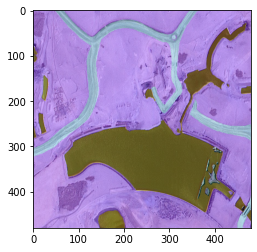

In [ ]:
img, mask = train_dataset[0]
visualize_sample(img, mask)

In [ ]:
def visualize_dataset(dataset, n=10):
  indices = np.random.randint(0, len(dataset), n)
  halfn = math.ceil(n//2)
  fig, axs = plt.subplots(halfn, 2, figsize=(20, 11*halfn))
  axs = axs.ravel()

  for i in range(n):
    idx = indices[i]
    img, mask = dataset[idx]
    visualize_sample(img, mask, ax=axs[i])

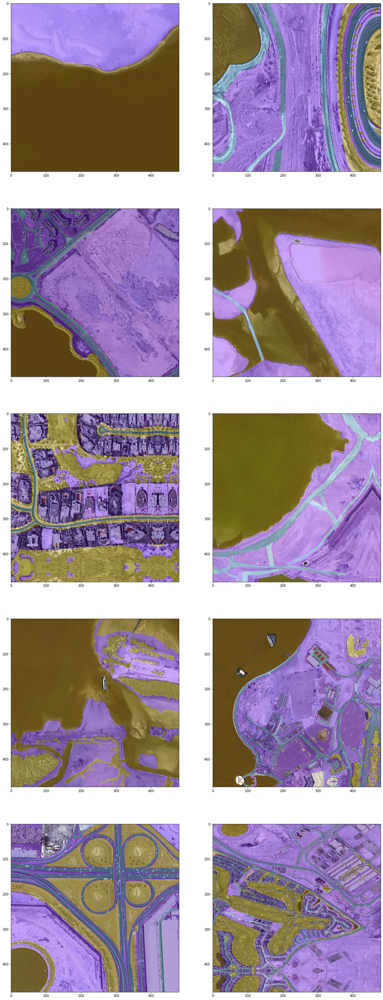

In [ ]:
visualize_dataset(train_dataset, 10)

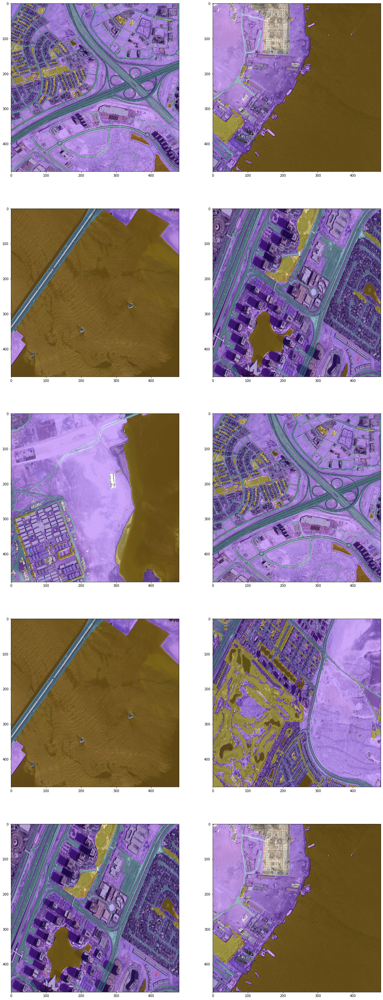

In [ ]:
visualize_dataset(val_dataset, 10)

# dataloader

In [ ]:
# utils for using gpu

device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

def to_device(data, device):
  """
  loads data onto device
  """
  if isinstance(data, (list, tuple)):
    return [to_device(d, device) for d in data]
  if isinstance(data, dict):
    return {k: to_device(v, device) for (k, v) in data.items()}
  return data.to(device, non_blocking=True)

class DeviceDataLoader():
  def __init__(self, dl, device):
    """
    wraps a pytorch dataloader
    for each batch that dataloader yields
    it loads that batch onto device
    """
    self.dl = dl
    self.device = device
  
  def __iter__(self):
    for data in self.dl:
      yield to_device(data, self.device)

  def __len__(self):
    return len(self.dl)

In [ ]:
TRAIN_BATCH_SIZE = 2
VAL_BATCH_SIZE = 2

train_dataloader = DataLoader(train_dataset,
                              batch_size=TRAIN_BATCH_SIZE,
                              shuffle=True)

val_dataloader = DataLoader(val_dataset,
                            batch_size=VAL_BATCH_SIZE,
                            shuffle=False)

In [ ]:
train_dataloader = DeviceDataLoader(train_dataloader, device)
val_dataloader = DeviceDataLoader(val_dataloader, device)

In [ ]:
for batch in train_dataloader:
  imgs, masks = batch
  print("imgs")
  print(imgs.shape)
  print(imgs.dtype)
  print("masks")
  print(masks.shape)
  print(masks.dtype)
  break

# model

In [ ]:
def create_model(checkpoint=None):
  
  weights = 'imagenet'
  if checkpoint is not None:
    weights = None

  model = smp.Unet(
    encoder_name='resnet50',
    encoder_weights=weights,
    in_channels=3,
    classes=len(CLASSES),
  )

  device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")

  if checkpoint is not None:
    model.load_state_dict(torch.load(checkpoint, map_location=device))

  return model

# loss function and metrics


In [ ]:
def pred_to_mask(ypred):
  """converts model prediction to mask

  ypred shape [batch, nclasses, height, weight]
  output shape [batch, height, weight] each element is int between [0 nclasses]
  """
  # ypred: [batch, n_classes, h, w]
  ypred = F.softmax(ypred, dim=1)
  ypred = torch.argmax(ypred, dim=1)
  # [batch, h, w] each element is integer between [0, n_classes-1]  
  return ypred

def iou(ypred, ytrue, n_classes, eps=1e-8, ignore_index=None):
  """computes iou for segemtation mask

  ypred and ytrue are masks of shape [b, h, w]
  each element is integer in range [0 n_classes]
  """

  ious = torch.zeros(n_classes)

  # only the classes that are present in the batch
  # will be set in this array. So we could use just
  # those clases for calculation of ious.
  ious_masks = torch.zeros(n_classes)

  for i in range(n_classes):

    # ignore unlabelled data    
    if ignore_index is not None and i == ignore_index:
      continue

    # pixels of classs i in model prediction
    cls_in_pred = (ypred == i)

    # pixels of classs i in ground truth
    cls_in_gt = (ytrue == i)

    # atleast 1 pixel of class i in either ground truth or prediction
    if cls_in_gt.sum() > 0 or cls_in_pred.sum() > 0:
      ious_masks[i] = 1

    # intersection of pred and gt for class i
    intersection = (cls_in_pred & cls_in_gt).sum()

    # union of pred and gt for class i
    union = cls_in_pred.sum() + cls_in_gt.sum() - intersection

    # iou
    iou = intersection / (union + eps)
    ious[i] = iou

  # number of classes in this batch
  classes_in_batch = ious_masks.sum()

  if classes_in_batch == 0:
    return 0

  return ious.sum() / classes_in_batch;

In [ ]:
def get_loss_fn(ignore_index=None):
  return smp.losses.DiceLoss('multiclass', 
                  classes=list(range(len(CLASSES))), 
                  from_logits=True,
                  ignore_index=ignore_index)

In [ ]:
def accuracy(ypred, ytrue, ignore_index=None):

  if ignore_index is not None:
    return ((ypred == ytrue) & (ytrue != ignore_index) & (ypred != ignore_index)).sum() / (ytrue != ignore_index).sum()

  return (ypred == ytrue).sum() / ytrue.numel()

In [ ]:
model = create_model(checkpoint=CHECKPOINT)
model = to_device(model, device)

In [ ]:
loss = get_loss_fn(ignore_index=IGNORE_INDEX)

imgs, masks = next(iter(train_dataloader))

ypred = model(imgs)

In [ ]:
loss(ypred, masks)

In [ ]:
ypred_mask = pred_to_mask(ypred)
iou(ypred_mask, masks, len(CLASSES), ignore_index=IGNORE_INDEX)

# training loop

In [ ]:
class Averager():
  def __init__(self):
    self.sum = 0
    self.num = 0
  
  @property
  def average(self):
    if self.num == 0:
      return 0
    return self.sum / self.num

  def add(self, value, batch_size):
    self.sum += (value * batch_size)
    self.num += batch_size

In [ ]:
def train_for_epoch(model, dataloader, optimizer, loss_fn, metric_fn, ignore_index=None):
  # accumulate loss and metric
  loss_averager = Averager()
  metric_averager = Averager()
  accuracy_averager = Averager()

  # put model in training mode
  model.train()

  for i, batch in enumerate(dataloader):

    # forward pass
    imgs, masks = batch
    batch_size = imgs.shape[0]
    optimizer.zero_grad()
    ypred = model(imgs)
    loss = loss_fn(ypred, masks)

    # backward pass
    loss.backward()

    # update weights
    optimizer.step()

    with torch.no_grad():

      # accumulate loss
      loss_averager.add(loss.item(), batch_size)
      
      # convert pred to mask
      ypred_mask = pred_to_mask(ypred)

      # compute and accumulate metric
      acc = accuracy(ypred_mask, masks, ignore_index=ignore_index)
      metric = metric_fn(ypred_mask, masks)
      metric_averager.add(metric, batch_size)
      accuracy_averager.add(acc, batch_size)

  # loss and metrics
  return loss_averager.average, metric_averager.average, accuracy_averager.average

In [ ]:
def evaluate(model, dataloader, loss_fn, metric_fn, ignore_index=None):
  # accumulate loss and metric
  loss_averager = Averager()
  metric_averager = Averager()
  accuracy_averager = Averager()

  # eval mode
  model.eval()

  for i, batch in enumerate(dataloader):
    # forward
    imgs, masks = batch
    batch_size = imgs.shape[0]
    ypred = model(imgs)
    loss = loss_fn(ypred, masks)

    # accumulate loss
    loss_averager.add(loss.item(), batch_size)

    # convert pred to mask
    ypred_mask = pred_to_mask(ypred)

    # compute and accumulate metric
    acc = accuracy(ypred_mask, masks, ignore_index=ignore_index)
    metric = metric_fn(ypred_mask, masks)
    metric_averager.add(metric, batch_size)
    accuracy_averager.add(acc, batch_size)

  # loss and metrics
  return loss_averager.average, metric_averager.average, accuracy_averager.average

# train model

In [ ]:
model = create_model(checkpoint=CHECKPOINT)
model = to_device(model, device)

In [ ]:
best_val_iou = 0
if best_val_iou > 0:
  model.load_state_dict(torch.load(f"best_model_iou:{best_val_iou:0.6f}"))

In [ ]:
# history
train_losses = []
train_ious = []
train_accs = []

val_losses = []
val_ious = []
val_accs = []

In [ ]:
loss_fn = get_loss_fn(ignore_index=IGNORE_INDEX)

def metric_fn(ypred, ytrue):
  return iou(ypred, ytrue, len(CLASSES), ignore_index=IGNORE_INDEX)

params = model.parameters()

optimizer = Adam(params, lr=0.0001)

scheduler = ReduceLROnPlateau(optimizer, 'min', factor=0.5, patience=2, min_lr=1e-6)

In [ ]:
def train(model, optimizer, start_epoch=1, end_epoch=10):
  global best_val_iou
  for epoch in range(start_epoch, end_epoch+1):

    # train
    train_loss, train_iou, train_acc = train_for_epoch(model, train_dataloader, optimizer, loss_fn, metric_fn, ignore_index=IGNORE_INDEX)
    train_losses.append(train_loss)
    train_ious.append(train_iou)
    train_accs.append(train_acc)
    print(f"\nEPOCH {epoch} train_loss {train_loss:0.6f} train_iou:{train_iou:0.6f} train_acc:{train_acc:0.6f}")

    # validate
    print("Evaluating")
    val_loss, val_iou, val_acc = evaluate(model, val_dataloader, loss_fn, metric_fn, ignore_index=IGNORE_INDEX)

    scheduler.step(val_loss)

    val_losses.append(val_loss)
    val_ious.append(val_iou)
    val_accs.append(val_acc)
    print(f"EPOCH {epoch} val_loss {val_loss:0.6f} val_iou:{val_iou:0.6f} val_acc:{val_acc:0.6f}")

    if val_iou > best_val_iou:
      best_val_iou = val_iou
      torch.save(model.state_dict(), f"best_model_iou:{val_iou:0.6f}")

In [ ]:
train(model, optimizer, 1, 10)

/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)



EPOCH 1 train_loss 0.480423 train_iou:0.340789 train_acc:0.560798
Evaluating
EPOCH 1 val_loss 0.367391 val_iou:0.463894 val_acc:0.744904

EPOCH 2 train_loss 0.349343 train_iou:0.450622 train_acc:0.702622
Evaluating
EPOCH 2 val_loss 0.296819 val_iou:0.538492 val_acc:0.777312

EPOCH 3 train_loss 0.304158 train_iou:0.488132 train_acc:0.736833
Evaluating
EPOCH 3 val_loss 0.307062 val_iou:0.514206 val_acc:0.764806

EPOCH 4 train_loss 0.278967 train_iou:0.517439 train_acc:0.763074
Evaluating
EPOCH 4 val_loss 0.294962 val_iou:0.522059 val_acc:0.781324

EPOCH 5 train_loss 0.263936 train_iou:0.532432 train_acc:0.778538
Evaluating
EPOCH 5 val_loss 0.261355 val_iou:0.564859 val_acc:0.803645

EPOCH 6 train_loss 0.261754 train_iou:0.533450 train_acc:0.785229
Evaluating
EPOCH 6 val_loss 0.270090 val_iou:0.553571 val_acc:0.818702

EPOCH 7 train_loss 0.250411 train_iou:0.550361 train_acc:0.798364
Evaluating
EPOCH 7 val_loss 0.265894 val_iou:0.560237 val_acc:0.812258

EPOCH 8 train_loss 0.235700 train

In [38]:
train(model, optimizer, 11, 20)


EPOCH 11 train_loss 0.214928 train_iou:0.585548 train_acc:0.824225
Evaluating
EPOCH 11 val_loss 0.243457 val_iou:0.591763 val_acc:0.836412

EPOCH 12 train_loss 0.210645 train_iou:0.597350 train_acc:0.831189
Evaluating
EPOCH 12 val_loss 0.244483 val_iou:0.589768 val_acc:0.840479

EPOCH 13 train_loss 0.198160 train_iou:0.607450 train_acc:0.841381
Evaluating
EPOCH 13 val_loss 0.245818 val_iou:0.582854 val_acc:0.832749

EPOCH 14 train_loss 0.197091 train_iou:0.611401 train_acc:0.844255
Evaluating
EPOCH 14 val_loss 0.246313 val_iou:0.587994 val_acc:0.840010

EPOCH 15 train_loss 0.191935 train_iou:0.627083 train_acc:0.852525
Evaluating
EPOCH 15 val_loss 0.241287 val_iou:0.596358 val_acc:0.839700

EPOCH 16 train_loss 0.184609 train_iou:0.636179 train_acc:0.852858
Evaluating
EPOCH 16 val_loss 0.238397 val_iou:0.599295 val_acc:0.844268

EPOCH 17 train_loss 0.185096 train_iou:0.634996 train_acc:0.859134
Evaluating
EPOCH 17 val_loss 0.246748 val_iou:0.587523 val_acc:0.842632

EPOCH 18 train_loss

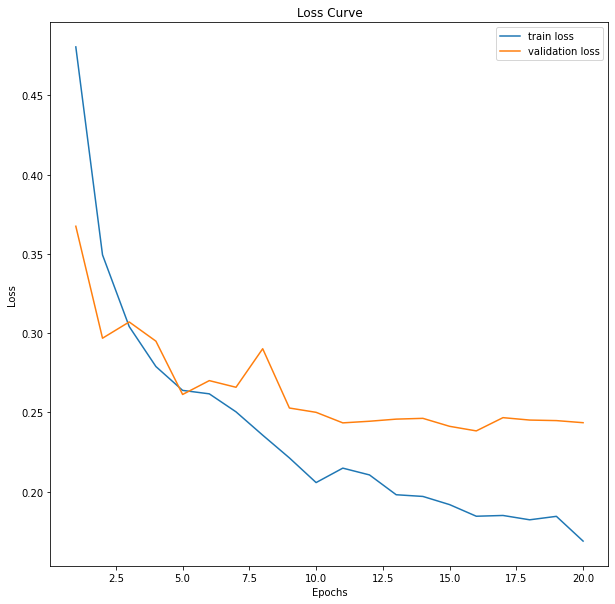

In [66]:
epochs = range(1, len(train_losses)+1)
plt.figure(figsize=(10, 10))
plt.plot(epochs, train_losses, label='train loss')
plt.plot(epochs, val_losses, label='validation loss')
plt.legend()
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title("Loss Curve");

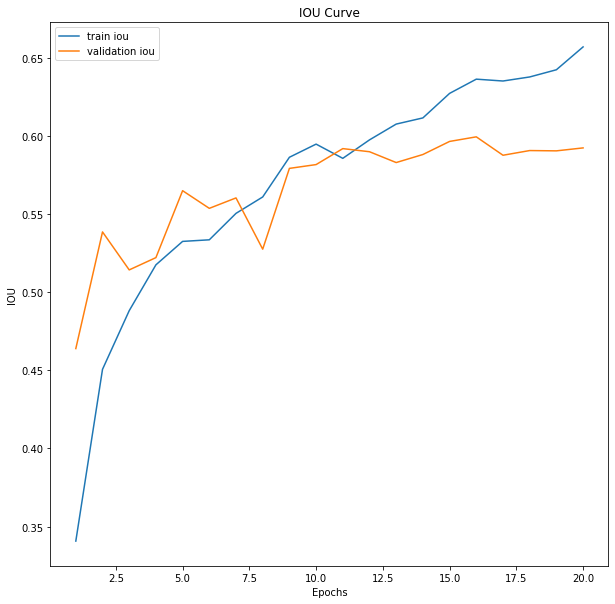

In [67]:
epochs = range(1, len(train_ious)+1)
plt.figure(figsize=(10, 10))
plt.plot(epochs, train_ious, label='train iou')
plt.plot(epochs, val_ious, label='validation iou')
plt.legend()
plt.xlabel('Epochs')
plt.ylabel('IOU')
plt.title("IOU Curve");

In [39]:
# load best model so far
if best_val_iou > 0:
  model.load_state_dict(torch.load(f"best_model_iou:{best_val_iou:0.6f}"))

# visualize predictions

In [40]:
def overlay_mask(img, mask, ax):
  """
  shows overlay and mask
  """
  # (c, h, w) -> (h, w, c)
  img = img.permute(1, 2, 0).clone().detach().cpu().numpy()
  mask = mask.cpu().numpy()

  # resize to size of mask
  img = cv2.resize(img, (mask.shape[1], mask.shape[0]))

  img = img * stds + means

  # (h, w) -> (h, w, c) replaces each classIndex with color values
  mask = colorize_label(mask, alpha=True)

  # show image
  ax.imshow(img)

  # show mask
  ax.imshow(mask, alpha=0.8)

def visualize_prediction(img, mask, pred, axs=None):
  """
  visualize prediction and ground truth mask
  """
  if axs is None:
    _, axs = plt.subplot(1, 2)
  ax0, ax1 = axs.ravel()
  
  pred = pred.unsqueeze(0)  # add batch dimension
  pred = pred_to_mask(pred) # convert to mask
  pred = pred.squeeze(0)    # remove batch dimension

  overlay_mask(img, mask, ax0)
  overlay_mask(img, pred, ax1)

def visualize_random_predictions(model, dataset, n=10):
  """
  visualize random predictions
  """
  model.eval()
  indices = np.random.randint(0, len(dataset), n)
  fig, axs = plt.subplots(n, 2, figsize=(20, 11*n))
  for i in range(n):
    img, mask = dataset[indices[i]]
    img = to_device(img, device)
    batch = img.unsqueeze(0)
    ypred = model(batch)
    ypred = ypred.squeeze(0)
    visualize_prediction(img, mask, ypred, axs=axs[i])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


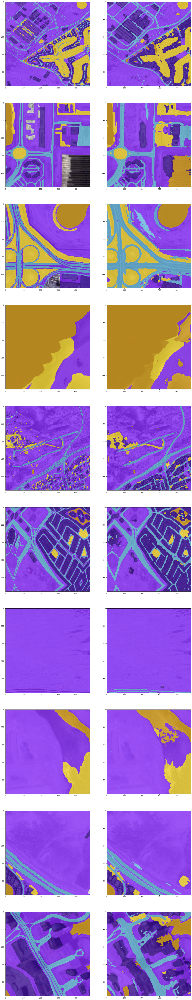

In [41]:
visualize_random_predictions(model, train_dataset, n=10)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

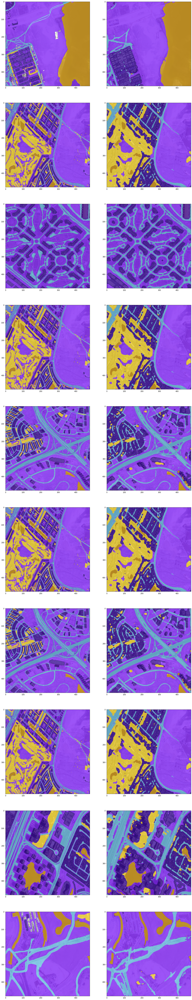

In [42]:
visualize_random_predictions(model, val_dataset, n=10)

# evaluate
* iou per class
* confusion matrix

In [58]:
def batch_confusion_matrix(ypred, ytrue, labels):
  """
  ypred and ytrue are masks of shape [b, h, w]
  each element is integer in range [0 n_classes]
  labels is array of len n_classes
  """
  ytrue = ytrue.flatten().detach().cpu().numpy()
  ypred = ypred.flatten().detach().cpu().numpy()
  return confusion_matrix(ytrue, ypred, labels=labels)

def per_class_iou(ypred, ytrue, n_classes, eps=1e-8, ignore_index=None):
  """computes iou for segemtation mask

  ypred and ytrue are masks of shape [b, h, w]
  each element is integer in range [0 n_classes]
  """

  ious = torch.zeros(n_classes)

#   print("init ious")
#   print(ious)
#   print("ignore index")
#   print(ignore_index)
  
  # only the classes that are present in the batch
  # will be set in this array. So we could use just
  # those clases for calculation of ious.
  ious_masks = torch.zeros(n_classes)

  for i in range(n_classes):
    if ignore_index is not None and i == ignore_index:
      continue

    # pixels of classs i in model prediction
    cls_in_pred = (ypred == i)

    # pixels of classs i in ground truth
    cls_in_gt = (ytrue == i)

    # atleast 1 pixel of class i in ground truth image
    if cls_in_gt.sum() > 0 or cls_in_pred.sum() > 0:
      ious_masks[i] = 1

    # intersection of pred and gt for class i
    intersection = (cls_in_pred & cls_in_gt).sum()

    # union of pred and gt for class i
    union = cls_in_pred.sum() + cls_in_gt.sum() - intersection

    # iou
    iou = intersection / (union + eps)
    ious[i] = iou

  return ious, ious_masks;

def generate_report(model, dataloader, n_classes, ignore_index=None):
  model.eval()

  cf_matrix = None
  iou_masks = None
  class_wise_iou = None
  # n_samples = 0

  for i, batch in enumerate(dataloader):
    imgs, masks = batch
    batch_size = len(imgs)
    
    ypred = model(imgs)
    ypred = pred_to_mask(ypred)
    # ypred=masks
    
    cf_mat = batch_confusion_matrix(ypred, masks, list(range(n_classes)))
    cls_ious, cls_ious_masks = per_class_iou(ypred, masks, n_classes, ignore_index=ignore_index)
    # cls_ious *= batch_size
    # n_samples += batch_size

    if cf_matrix is None:
      cf_matrix = cf_mat
      class_wise_iou = cls_ious
      iou_masks = cls_ious_masks
    else:
      cf_matrix += cf_mat
      class_wise_iou += cls_ious
      iou_masks += cls_ious_masks

  # average iou per 
  for j, n in enumerate(iou_masks):
    if n != 0:
      class_wise_iou[j] /= n

  return {
      'confusion_matrix': cf_matrix,
      'class_wise_iou': class_wise_iou,
      'class_wise_iou_masks': iou_masks,
      'average_iou': class_wise_iou.sum() / (iou_masks > 0).sum()
  }

In [ ]:
imgs, masks = next(iter(train_dataloader))
print(per_class_iou(masks, masks, len(CLASSES), ignore_index=IGNORE_INDEX))

In [59]:
report = generate_report(model, val_dataloader, len(CLASSES), ignore_index=IGNORE_INDEX)

In [60]:
print(f"average iou {report['average_iou']:0.2f}")

average iou 0.60


In [61]:
pd.DataFrame(report['class_wise_iou'], index=CLASSES, columns=['iou']).sort_values('iou', ascending=False)

,iou
water,0.847082
land,0.711206
building,0.613619
road,0.559800
vegetation,0.264767
unlabeled,0.000000


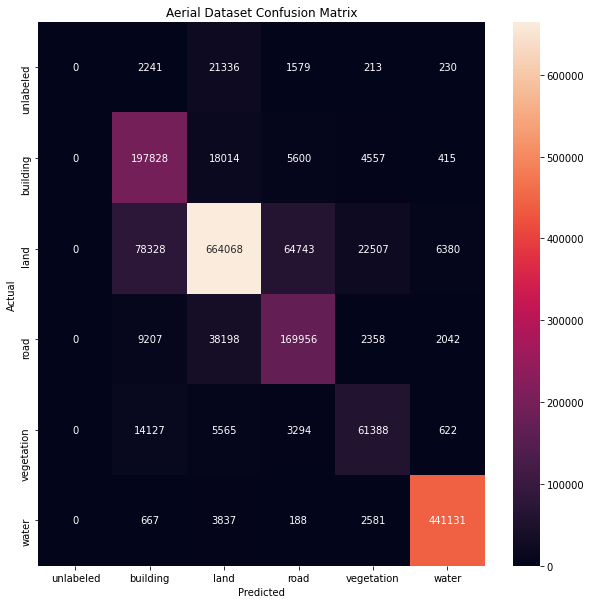

In [73]:
fig = plt.figure(figsize=(10, 10))
ax =sns.heatmap(report['confusion_matrix'], 
            ax=fig.gca(), 
            fmt='d', 
            xticklabels=CLASSES, 
            yticklabels=CLASSES,
            annot=True,
            # xlabel='Predicted',
            # ylabel='Actual',
)
ax.set(
    xlabel='Predicted',
    ylabel='Actual',
    title='Aerial Dataset Confusion Matrix',
);